# PROJECT OVERVIEW
This project addresses the State Farm Distracted Driver Detection challenge by classifying driver behaviors using dashboard camera images. We begin with exploratory data analysis (EDA) to establish a baseline comparison between non-distracted and distracted driving. After visualizing and understanding the data, we implement a custom CNN, followed by ResNet to improve performance. Our goal is to build an accurate, generalizable model that distinguishes safe driving from risky behaviors.

In [1]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

# Standard libraries
import os
import random
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg

# Image processing
import cv2
from PIL import Image
from glob import glob

# Data handling
import h5py
from sklearn.model_selection import train_test_split

# TensorFlow & Keras
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import (
    Input, Conv2D, MaxPooling2D, Flatten, 
    Dense, Dropout, GlobalAveragePooling2D
)
from tensorflow.keras.applications import VGG19, ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Check input files
print(os.listdir("../input"))

2025-07-27 19:10:22.056498: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1753643422.082248    1729 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1753643422.090347    1729 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


['state-farm-distracted-driver-detection']


# Setting Directory Paths

In [2]:
directory = "../input/state-farm-distracted-driver-detection/imgs/train"
test_directory = "../input/state-farm-distracted-driver-detection/imgs/test"
random_test = '../input/driver/'
classes = ['c0','c1','c2','c3','c4','c5','c6','c7','c8','c9']

In [3]:
# Map label codes to descriptions
col = {
    'c0': 'safe driving',
    'c1': 'texting - right',
    'c2': 'talking on the phone - right',
    'c3': 'texting - left',
    'c4': 'talking on the phone - left',
    'c5': 'operating the radio',
    'c6': 'drinking',
    'c7': 'reaching behind',
    'c8': 'hair and makeup',
    'c9': 'talking to passenger'
}

In [4]:
print("Training directory contents:", os.listdir(directory))


Training directory contents: ['c5', 'c7', 'c8', 'c2', 'c6', 'c4', 'c3', 'c1', 'c9', 'c0']


In [5]:
# create placeholders
training_data = []
testing_data = []

In [6]:
def preprocess_image(img, img_size=(240, 240), augment=False):
    img = cv2.resize(img, img_size)
    img = img.astype(np.float32) / 255.0

    if augment:
        if random.random() < 0.5:
            img = cv2.flip(img, 1)
        if random.random() < 0.3:
            factor = 0.5 + random.uniform(0, 1)
            img = np.clip(img * factor, 0, 1)
        if random.random() < 0.3:
            angle = random.uniform(-15, 15)
            M = cv2.getRotationMatrix2D((img.shape[1] // 2, img.shape[0] // 2), angle, 1)
            img = cv2.warpAffine(img, M, (img.shape[1], img.shape[0]), borderMode=cv2.BORDER_REFLECT)
        if random.random() < 0.3:
            h, w = img.shape[:2]
            zoom_scale = random.uniform(0.85, 1.0)
            nh, nw = int(h * zoom_scale), int(w * zoom_scale)
            y1 = random.randint(0, h - nh)
            x1 = random.randint(0, w - nw)
            img = img[y1:y1+nh, x1:x1+nw]
            img = cv2.resize(img, (w, h))
        if random.random() < 0.3:
            noise = np.random.normal(0, 0.02, img.shape)
            img = np.clip(img + noise, 0, 1)

    return img

## Image Preprocessing and Data Augmentation

To improve model generalization and robustness, we implemented a modular preprocessing function that standardizes all input images and applies targeted augmentations to the training data.

### Preprocessing Steps
Each image is:
- **Resized** to 240×240 pixels for input consistency across models
- **Normalized** to the [0, 1] range to stabilize model training

---

###  Data Augmentation Strategy

We apply a set of **controlled, probabilistic augmentations** to the training set. These augmentations simulate realistic in-vehicle variations, helping the model become invariant to lighting, orientation, and occlusion artifacts — all common in distracted driver detection.

| Augmentation        | Purpose                                                             |
|---------------------|----------------------------------------------------------------------|
| **Random Flip**     | Simulates mirrored perspectives  |
| **Brightness Shift**| Simulates variable lighting (sun glare, shadows, dashboard glow)     |
| **Random Rotation** | Captures slight camera tilt or head lean                             |
| **Random Zoom-In**  | Mimics closer positioning or crop from posture changes               |
| **Gaussian Noise**  | Simulates sensor noise or compression artifacts                      |

Each transformation is applied with a fixed probability (30–50%) to avoid overfitting and encourage the model to learn **robust spatial and contextual features** rather than memorizing static patterns.

---

### Why This Matters for the State Farm Dataset

The State Farm Distracted Driver dataset includes **subtle distinctions between classes** like:
- Texting vs. talking
- Left-hand vs. right-hand use
- Reaching vs. drinking

These behaviors often result in:
- Slight posture changes
- Lighting shifts due to arm/head movement
- Occlusions (e.g., hand in front of face or object)

Our augmentation pipeline addresses these challenges directly by training the model to:
- Ignore irrelevant noise (lighting, zoom, rotation)
- Focus on the core behavior signals
- Generalize better across different drivers and camera angles

---

**Note:** Augmentation is turned **off** during EDA and validation to preserve data integrity.


In [7]:
def create_training_data(augment=False):
    training_data.clear()
    for category in classes:
        path = os.path.join(directory, category)
        class_num = classes.index(category)
        if os.path.exists(path):
            for img_name in os.listdir(path):
                try:
                    img = cv2.imread(os.path.join(path, img_name), cv2.IMREAD_COLOR)
                    if img is not None:
                        processed = preprocess_image(img, augment=augment)
                        training_data.append([processed, class_num])
                except Exception as e:
                    print(f"Error reading image {img_name}: {e}")

In [8]:
def create_testing_data():
    testing_data.clear()
    if os.path.exists(test_directory):
        for img_name in os.listdir(test_directory):
            try:
                img = cv2.imread(os.path.join(test_directory, img_name), cv2.IMREAD_COLOR)
                if img is not None:
                    processed = preprocess_image(img, augment=False)
                    testing_data.append([img_name, processed])
            except Exception as e:
                print(f"Error reading test image {img_name}: {e}")

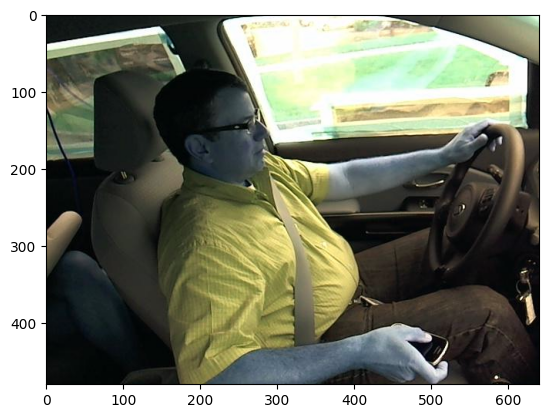

In [9]:
for i in classes:
    path = os.path.join(directory,i)
    for img in os.listdir(path):
        img_array = cv2.imread(os.path.join(path,img),cv2.IMREAD_COLOR)
        plt.imshow(img_array, cmap='gray')
        plt.show()
        break
    break

In [10]:
def read_image(path):
    img = cv2.imread(path, cv2.IMREAD_COLOR)  
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    return img

Class c0 : safe driving


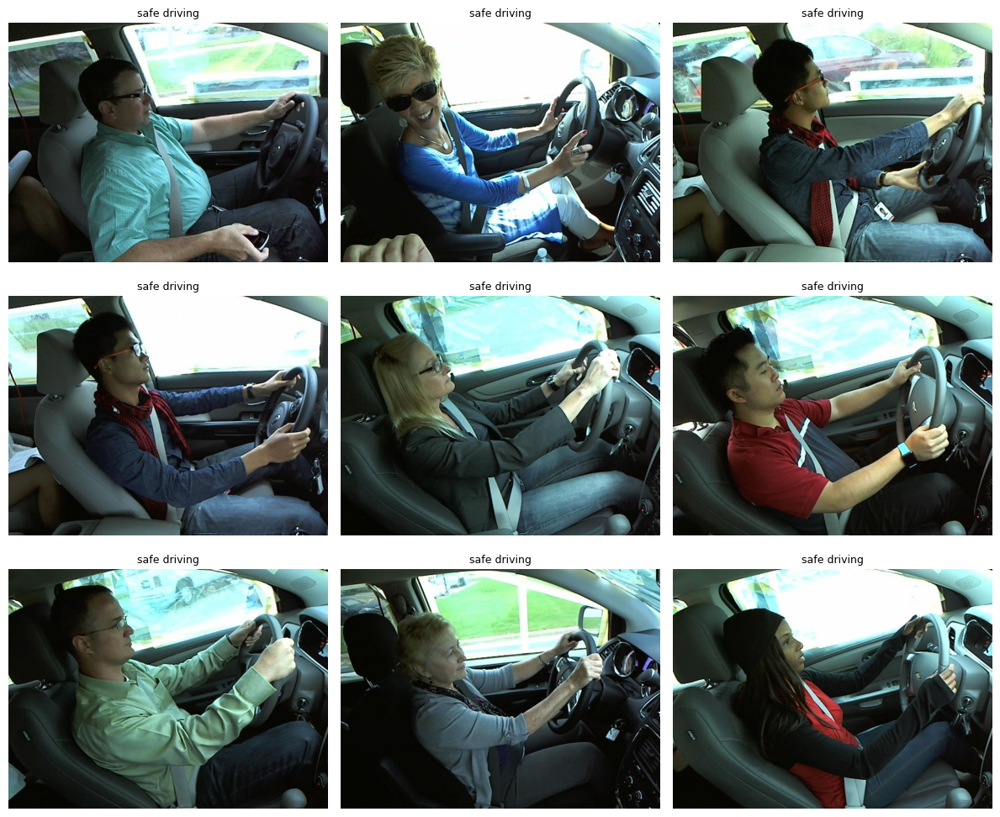

Class c1 : texting - right


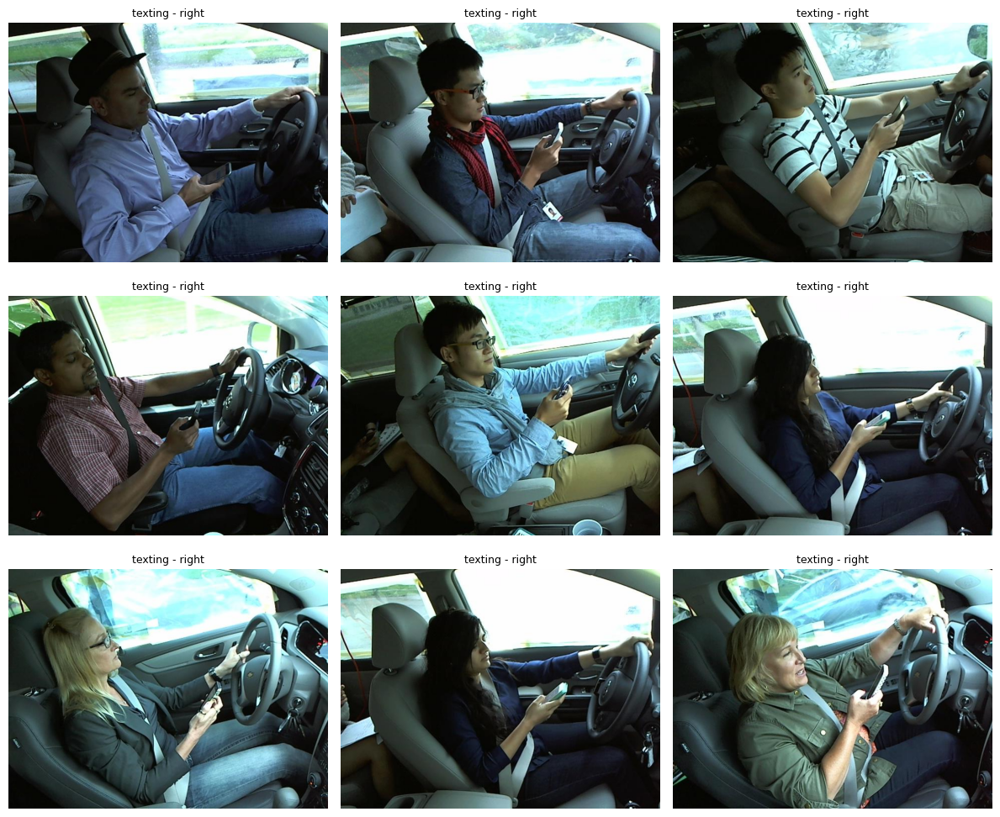

Class c2 : talking on the phone - right


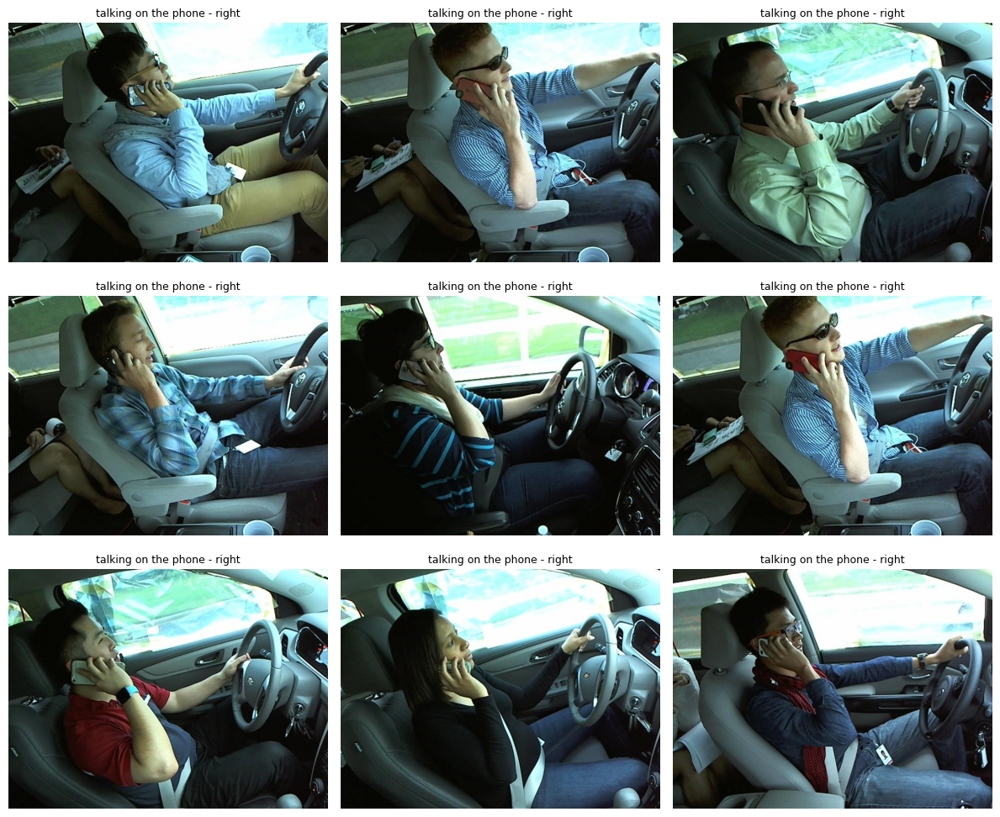

Class c3 : texting - left


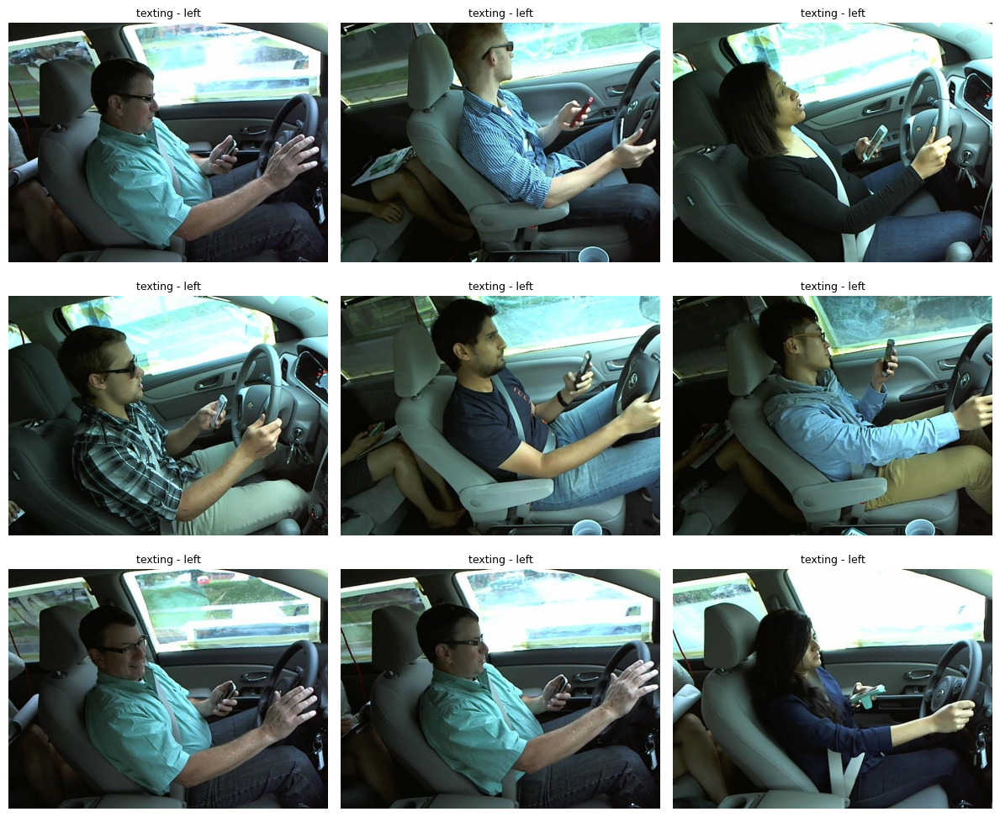

Class c4 : talking on the phone - left


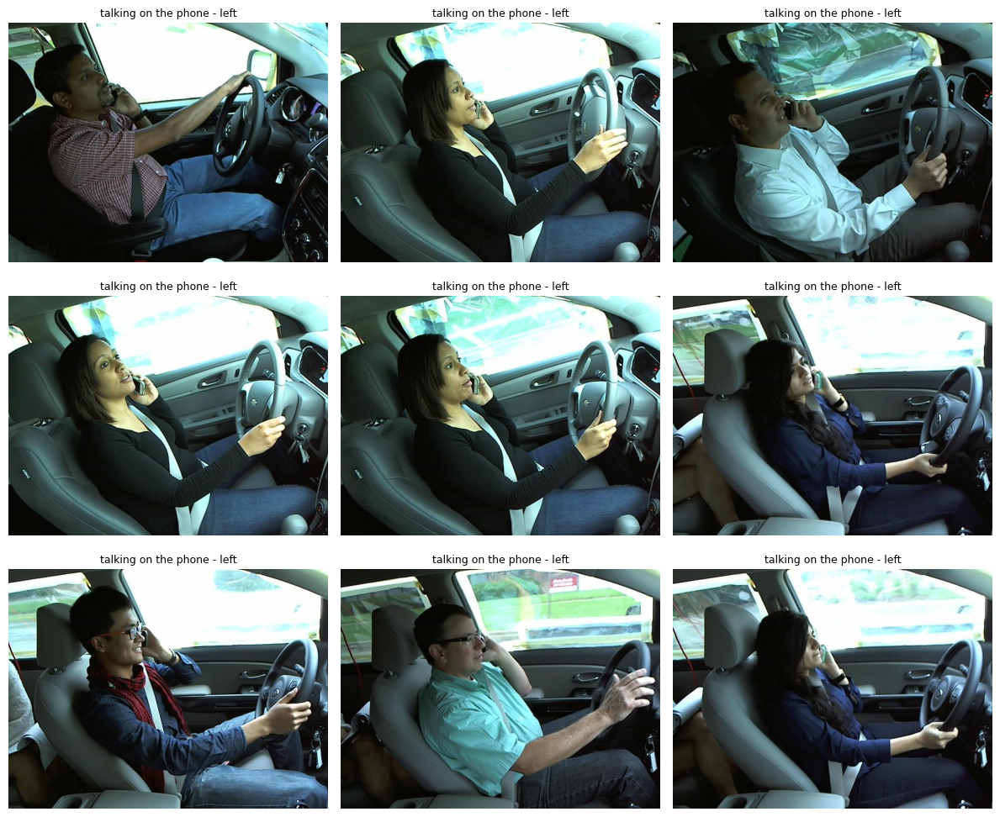

Class c5 : operating the radio


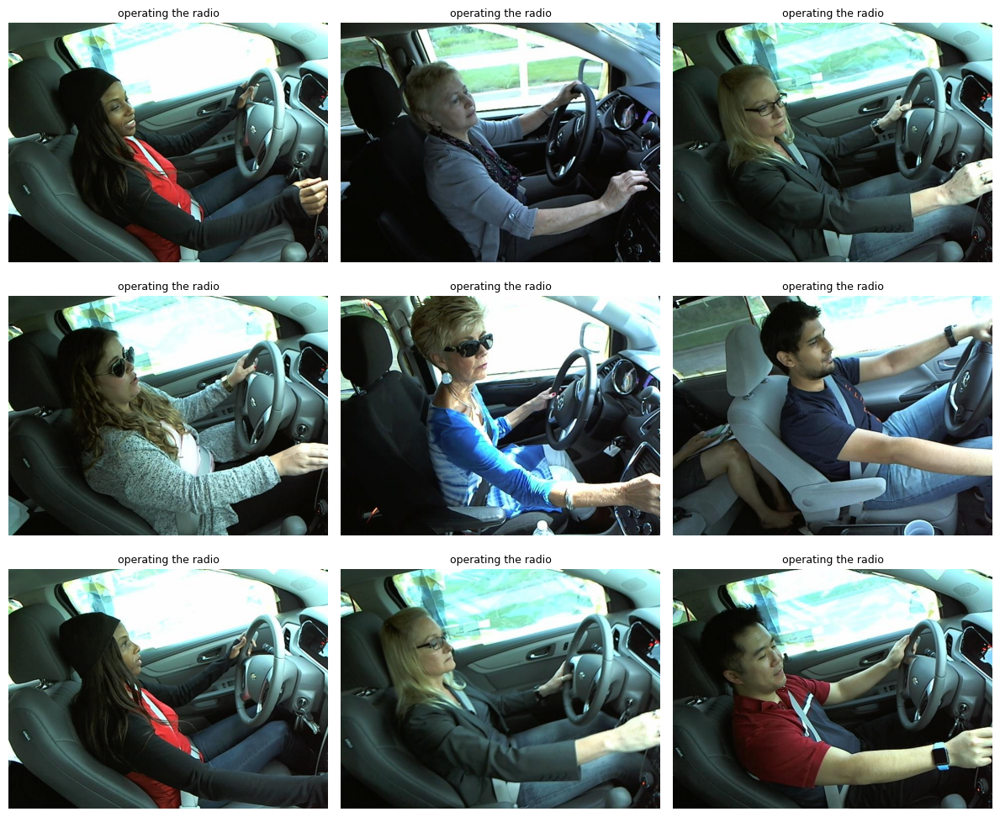

Class c6 : drinking


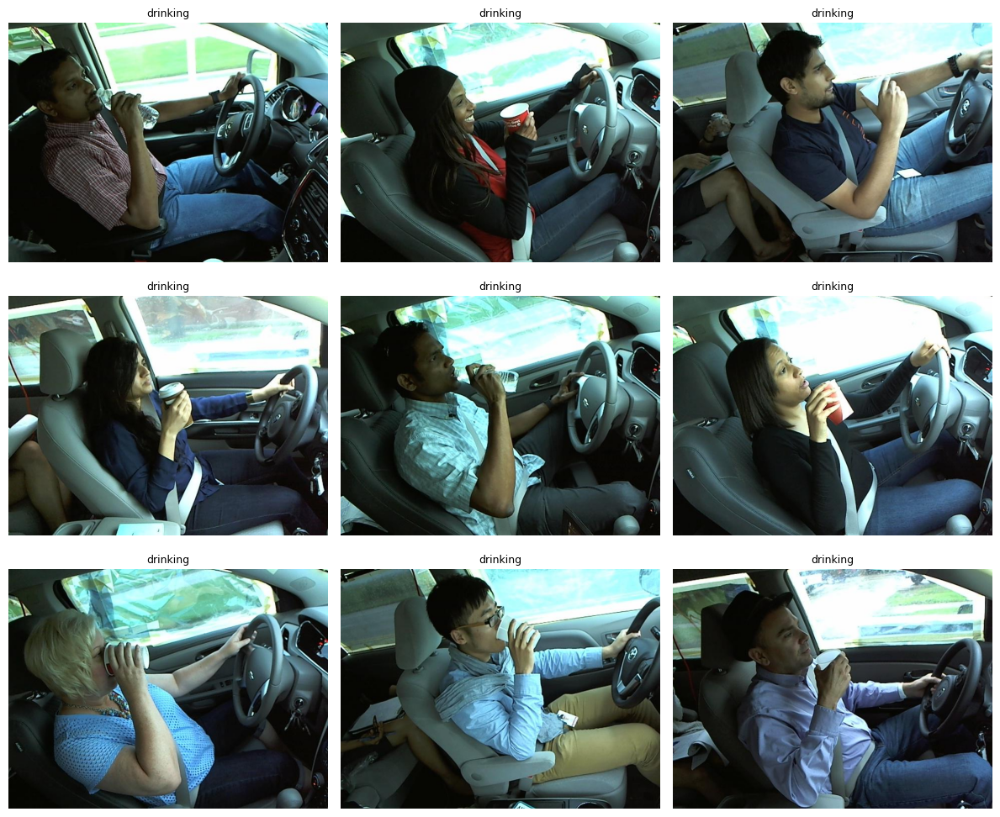

Class c7 : reaching behind


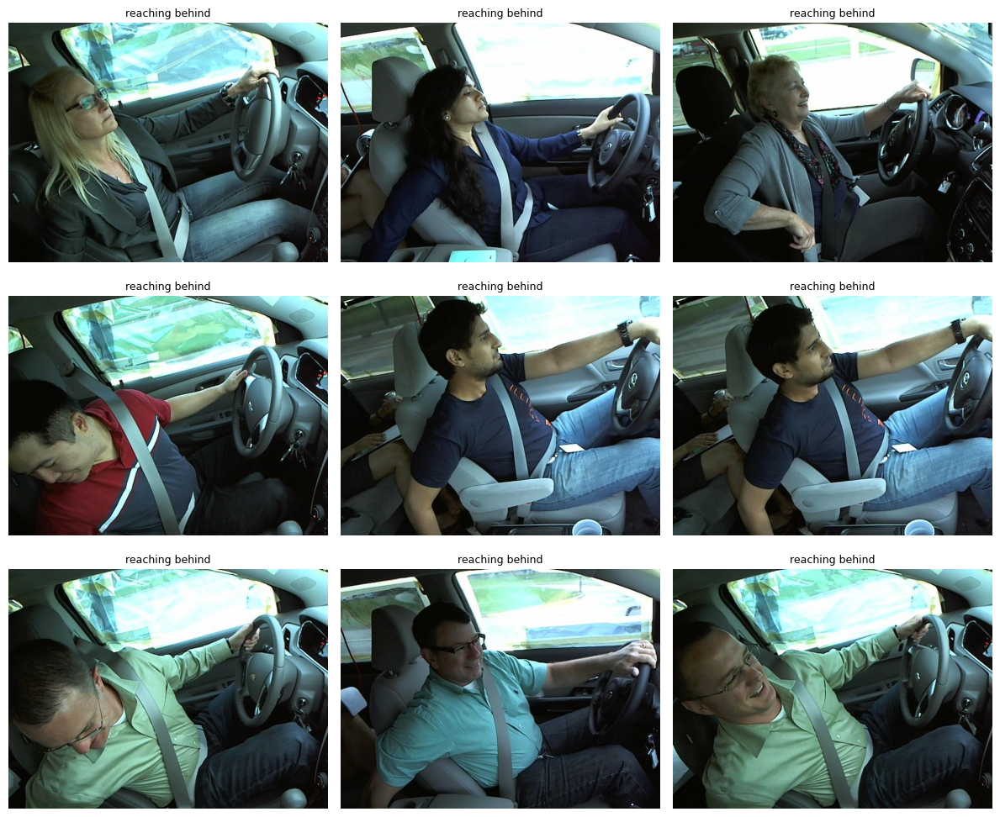

Class c8 : hair and makeup


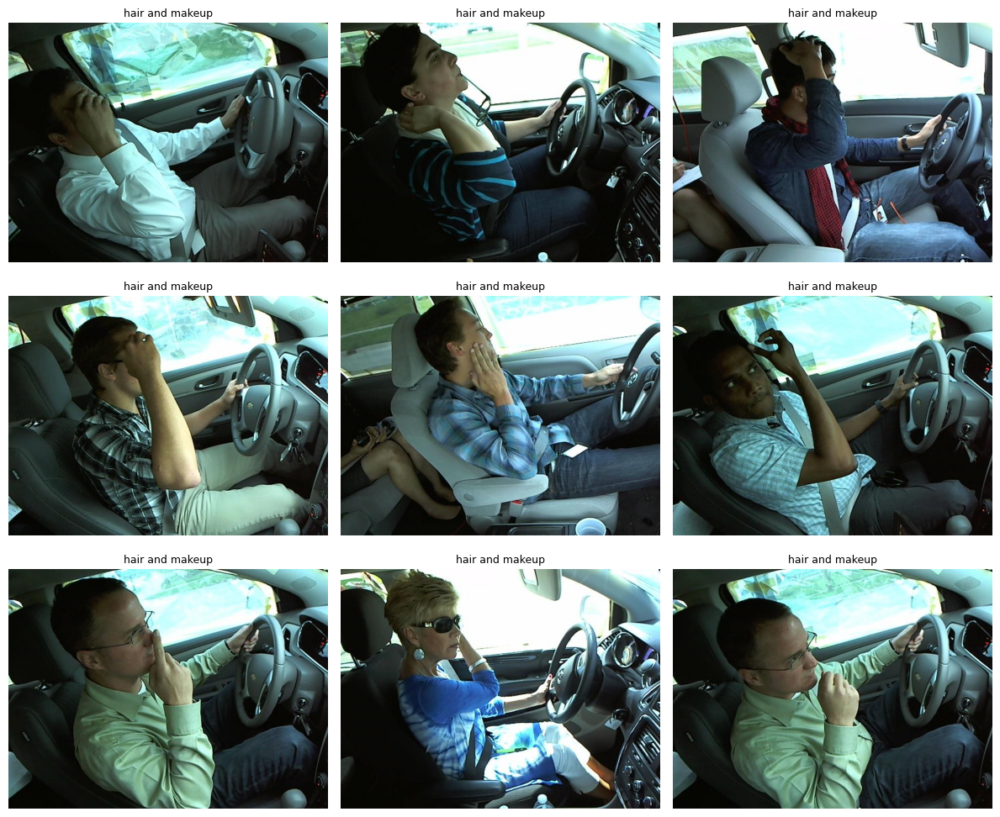

Class c9 : talking to passenger


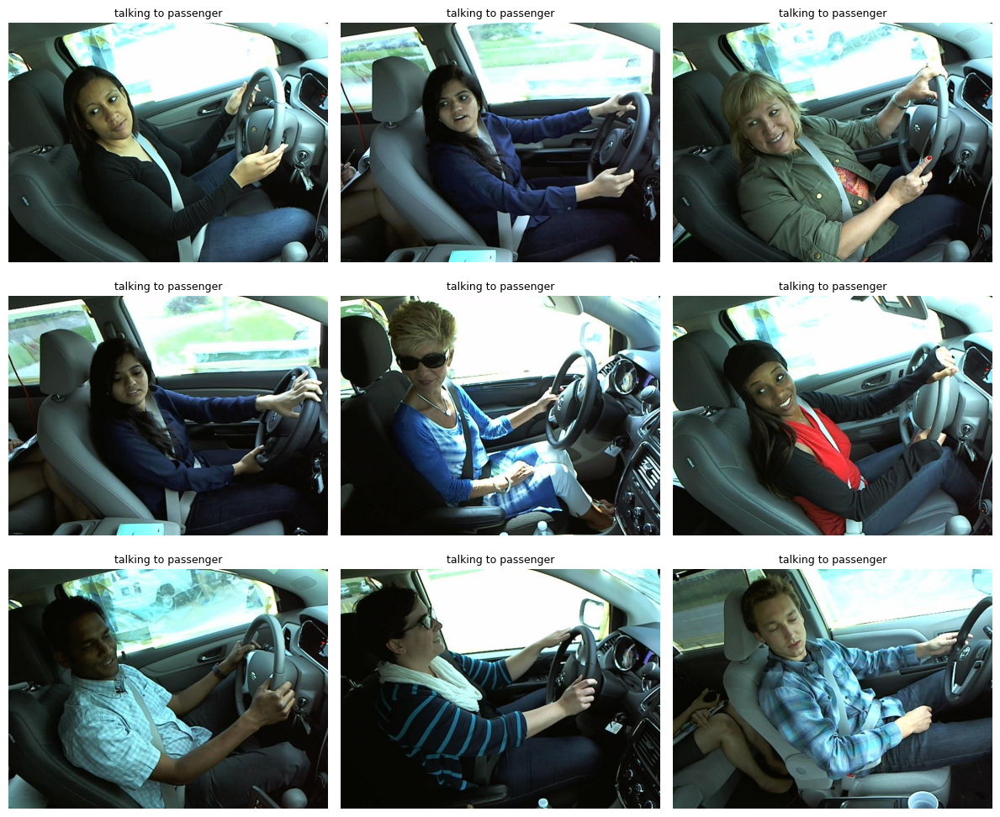

In [11]:
#Output directory for saving images
output_dir = "/kaggle/working/image_grids"
os.makedirs(output_dir, exist_ok=True)

for c in classes:
    f, ax = plt.subplots(figsize=(12, 10))
    files = glob(f"{directory}/{c}/*.jpg")

    print(f"Class {c} : {col[c]}")

    for x in range(9):
        plt.subplot(3, 3, x+1)
        image = read_image(files[x])
        plt.imshow(image)
        plt.title(col[c], fontsize=9)
        plt.axis('off')

    plt.tight_layout()
    
    
    save_path = os.path.join(output_dir, f"{c}_{col[c].replace(' ', '_')}.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.show()

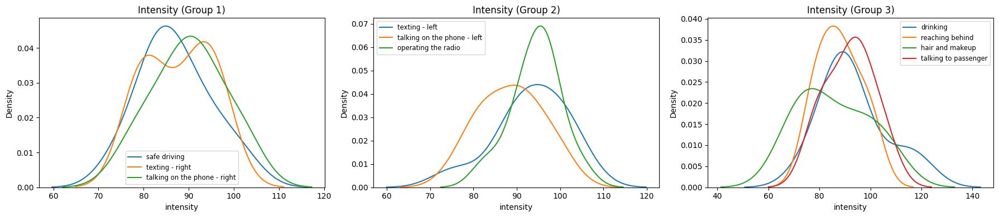

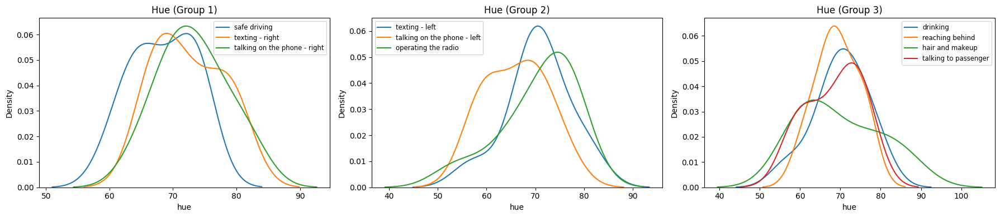

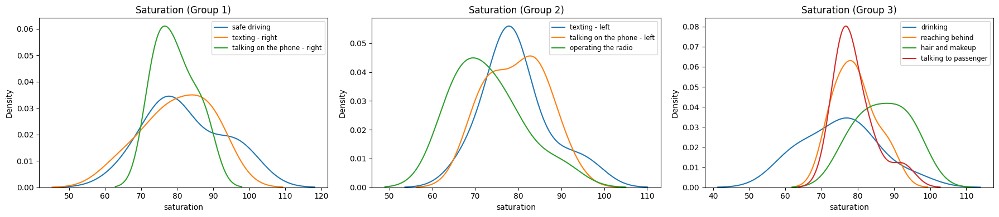

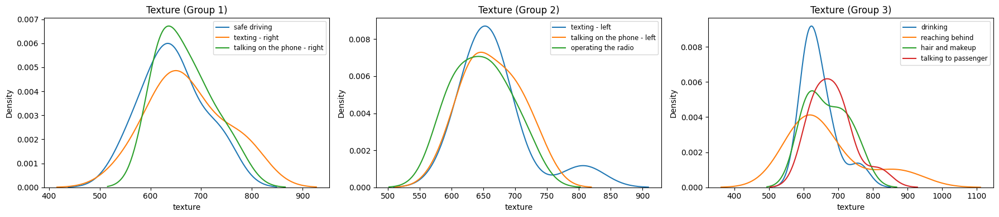

In [12]:
class_groups = [
    [col['c0'], col['c1'], col['c2']],
    [col['c3'], col['c4'], col['c5']],
    [col['c6'], col['c7'], col['c8'], col['c9']]
]

# Texture calculation
def calculate_texture(image):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
    magnitude = np.sqrt(sobelx**2 + sobely**2)
    return magnitude.mean()

# Extract features
directory = "../input/state-farm-distracted-driver-detection/imgs/train"
data_summary = {'class': [], 'intensity': [], 'hue': [], 'saturation': [], 'texture': []}
samples_per_class = 10  # Small sample for performance

for c in classes:
    files = glob(f"{directory}/{c}/*.jpg")
    selected_files = random.sample(files, min(samples_per_class, len(files)))
    for file in selected_files:
        img = cv2.imread(file)
        if img is None:
            continue
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        data_summary['class'].append(col[c])
        data_summary['intensity'].append(img_rgb.mean())
        data_summary['hue'].append(hsv[..., 0].mean())
        data_summary['saturation'].append(hsv[..., 1].mean())
        data_summary['texture'].append(calculate_texture(img_rgb))


df = pd.DataFrame(data_summary)
df['class'] = df['class'].astype(str).str.strip()

# Save paths
features = ['intensity', 'hue', 'saturation', 'texture']
plot_dir = "/kaggle/working/kde_feature_plots"
os.makedirs(plot_dir, exist_ok=True)
excel_path = "/kaggle/working/Feature_Distributions.xlsx"
writer = pd.ExcelWriter(excel_path, engine='openpyxl')



for i, feature in enumerate(features):
    fig, axes = plt.subplots(1, len(class_groups), figsize=(18, 4))
    for j, group in enumerate(class_groups):
        ax = axes[j]
        for label in group:
            subset = df[df['class'] == label][feature].dropna()
            if not subset.empty:
                sns.kdeplot(subset, label=label, ax=ax)
        ax.set_title(f"{feature.capitalize()} (Group {j+1})")
        ax.legend(fontsize='small')
    
    plt.tight_layout()
    plot_file = os.path.join(plot_dir, f"{feature}_kde.png")
    plt.savefig(plot_file, dpi=300, bbox_inches='tight')
    plt.show()  
    plt.close()
    
    # Save feature data to Excel
    df_subset = df[['class', feature]].dropna()
    df_subset.to_excel(writer, sheet_name=feature[:31], index=False)

writer.close()

## Class-Level Visual Feature Analysis using KDE Distributions

This section presents a detailed exploratory analysis of each driver behavior class using kernel density estimation (KDE) plots across four visual features:
- **Pixel Intensity**
- **Hue**
- **Saturation**
- **Texture** (computed via Sobel edge magnitude)

The features were extracted from 50 randomly sampled images. Classes are grouped and visualized 3 at a time for comparison.

---

### **c0 — Safe Driving**
**Key Point:**  
This class represents the **baseline behavior** where the driver is focused and not distracted. It is the most visually uniform class and serves as a control group for identifying deviations caused by distractions.

**Key Characteristics:**
- **Intensity:** Centered around 85 with a tight distribution, suggesting stable lighting and minimal variation.
- **Hue:** Concentrated near 65, consistent with neutral tones (e.g., dashboard, seatbelt).
- **Saturation:** Lower and narrower than most other classes, indicating minimal color variation — no hands, phones, or bright objects.
- **Texture:** Generally smooth (peak < 700), reflecting fewer sharp edges and little motion — no raised arms or facial expressions.

**Differentiation:**  
Safe driving is clearly distinguishable by its **consistency**, **low texture**, and **muted saturation**, in contrast to the heightened variation seen in distracted behaviors.

---

### **c1 — Texting (Right Hand)**
**Key Point:**  
Increased hand motion on the right side introduces sharper edges and variation.

**Key Differentiators:**
- **Texture:** Notably higher than safe driving, due to hand/arm positioning.
- **Saturation:** Shows a sharper and narrower distribution — possible phone screen or reflective object.
- **Hue:** Slight rightward shift suggesting new color sources (e.g., phone cases or skin tones).

---

### **c2 — Talking on Phone (Right Hand)**
**Key Point:**  
Sustained phone-holding posture introduces high-frequency edges and occlusion near the face.

**Key Differentiators:**
- **Texture:** Similar to texting but even more peaked, due to concentrated edge areas.
- **Saturation:** Higher than safe driving — possibly due to face/phone contrast.
- **Intensity:** Slightly wider spread, suggesting variable shadows and highlights.

---

### **c3 — Texting (Left Hand)**
**Key Point:**  
Similar to c1 but with hand motion on the left side — features align closely with c1.

**Key Differentiators:**
- **Texture & Saturation:** Comparable to `c1`, confirming left-hand movement causes similar visual disruption.
- **Hue:** Slight variation depending on lighting angle differences from the left.

---

### **c4 — Talking on Phone (Left Hand)**
**Key Point:**  
Mirror effect of c2, with high texture from phone-hand occlusion on the opposite side.

**Key Differentiators:**
- **Hue & Intensity:** Show similar shift and spread as c2.
- **Texture:** Matches c2, but subtle differences in angle may affect edge strength.

---

### **c5 — Operating the Radio**
**Key Point:**  
Arm extension toward the center console introduces directional motion and color shifts.

**Key Differentiators:**
- **Texture:** Moderately high due to arm movement.
- **Hue & Saturation:** Slightly elevated; less structured than phone-based distractions.

---

### **c6 — Drinking**
**Key Point:**  
Brings a foreground object (bottle/cup) into view, affecting all visual features.

**Key Differentiators:**
- **Texture:** Often high due to object edges and motion.
- **Saturation:** Can vary widely depending on beverage container color.
- **Hue:** Disrupted by bottle transparency or labels.

---

### **c7 — Reaching Behind**
**Key Point:**  
Full-body motion creates large deviations in background and body posture.

**Key Differentiators:**
- **Texture:** Spiked; unusual edge contours appear.
- **Intensity & Hue:** Broader and less predictable due to seat/body twist.

---

### **c8 — Hair and Makeup**
**Key Point:**  
Face occlusion and hand proximity introduce local motion and increased reflectivity.

**Key Differentiators:**
- **Saturation:** Often sharp due to skin tone, cosmetic tools.
- **Texture:** Mid to high depending on hand/facial angle.
- **Hue:** Can vary more due to skin/makeup tones.

---

###  **c9 — Talking to Passenger**
**Key Point:**  
Head and eye motion changes, but minimal hand movement; subtler than other distractions.

**Key Differentiators:**
- **Texture:** Slightly elevated compared to safe driving, but lower than most distraction types.
- **Hue & Saturation:** Small shifts from face rotation and exposure to passenger lighting.

---

###  Summary

| Class | Primary Disruptors | Strongest Signal(s) |
|-------|--------------------|---------------------|
| c0 — Safe Driving | None | Low texture, stable intensity |
| c1–c4 — Phone/Text | Hand/face occlusion | High texture, sharp hue shifts |
| c5 — Radio | Arm extension | Moderate texture/saturation |
| c6 — Drinking | Foreground object | High texture, color variation |
| c7 — Reaching | Posture & twist | Irregular texture & hue |
| c8 — Makeup | Face/hand motion | High saturation/texture |
| c9 — Talking | Head/eye motion | Mild texture increase |

These insights provide a foundation for feature engineering and model interpretability in distraction classification tasks.


In the next code chunk we display one KDE plot per class to aid visualiztion and comparative analysis.

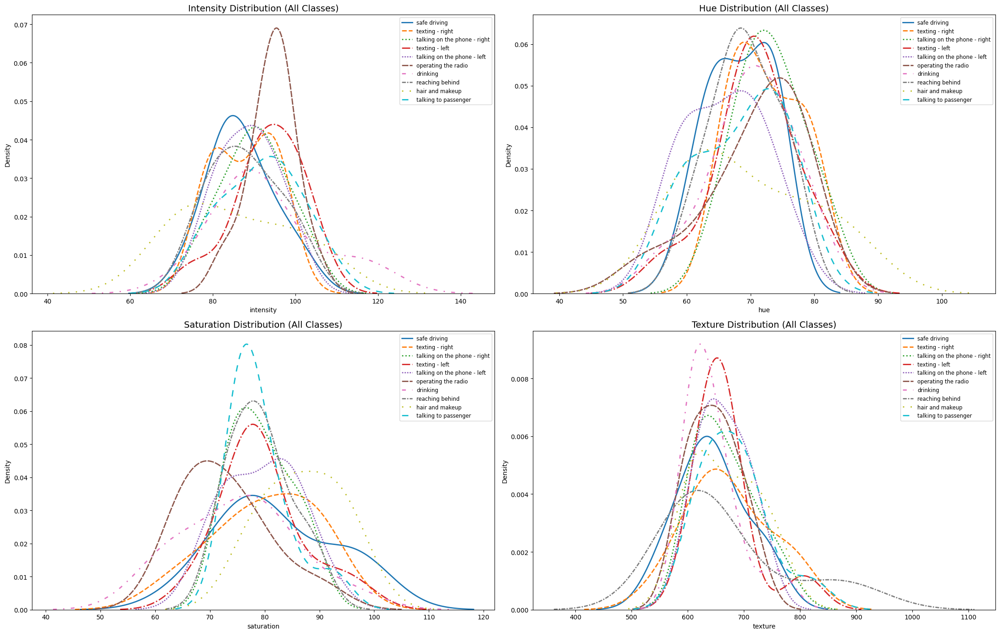

In [13]:
df['class'] = df['class'].astype(str).str.strip()

colors = sns.color_palette("tab10", n_colors=10)
linestyles = [
    'solid', 'dashed', 'dotted', 'dashdot',
    (0, (1, 1)), (0, (5, 1)), (0, (3, 5, 1, 5)),
    (0, (3, 1, 1, 1)), (0, (1, 5)), (0, (5, 5))
]

# Feature list
features = ['intensity', 'hue', 'saturation', 'texture']
fig, axes = plt.subplots(2, 2, figsize=(22, 14))
axes = axes.flatten()


for i, feature in enumerate(features):
    ax = axes[i]
    for idx, (key, label) in enumerate(col.items()):
        subset = df[df['class'] == label][feature].dropna()
        if not subset.empty:
            sns.kdeplot(
                subset,
                label=label,
                ax=ax,
                color=colors[idx],
                linestyle=linestyles[idx],
                linewidth=2
            )
    ax.set_title(f"{feature.capitalize()} Distribution (All Classes)", fontsize=14)
    ax.legend(fontsize='small')

plt.tight_layout()
plt.show()


In [14]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Base paths
train_dir = "../input/state-farm-distracted-driver-detection/imgs/train"
test_dir = "../input/state-farm-distracted-driver-detection/imgs/test"

# Training Data Generator with augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    validation_split=0.2
)

# Validation Data Generator without augmentation
val_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

# Train and Validation Generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(240, 240),
    batch_size=32,
    class_mode='categorical',
    subset='training'
)

val_generator = val_datagen.flow_from_directory(
    train_dir,
    target_size=(240, 240),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

Found 17943 images belonging to 10 classes.
Found 4481 images belonging to 10 classes.


# Modeling

We begin modeling with a basic CNN model to provide a performance baseline

In [15]:
def build_cnn_model(input_shape=(240, 240, 3), num_classes=10):
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        MaxPooling2D(pool_size=(2, 2), strides=2),

        Conv2D(64, (3, 3), activation='relu', padding='same'),
        MaxPooling2D(pool_size=(2, 2), strides=2),

        Conv2D(128, (3, 3), activation='relu', padding='same'),
        MaxPooling2D(pool_size=(2, 2), strides=2),

        Flatten(),
        Dropout(0.5),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(num_classes, activation='softmax')
    ])
    return model

# Callbacks
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3)


model = build_cnn_model()
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


model.summary()

I0000 00:00:1753643508.841948    1729 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 240, 240, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 120, 120, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 120, 120, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 60, 60, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    14,745,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,840,266 (56.61 MB)

 Trainable params: 14,840,266 (56.61 MB)

 Non-trainable params: 0 (0.00 B)

In [16]:
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=30,
    callbacks=[early_stop, lr_scheduler]
)

Epoch 1/30


I0000 00:00:1753643513.565705    1798 service.cc:148] XLA service 0x78b91400dac0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1753643513.565791    1798 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1753643513.935639    1798 cuda_dnn.cc:529] Loaded cuDNN version 90300


  1/561 ━━━━━━━━━━━━━━━━━━━━ 1:14:18 8s/step - accuracy: 0.0312 - loss: 2.3058

I0000 00:00:1753643518.483464    1798 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


561/561 ━━━━━━━━━━━━━━━━━━━━ 283s 492ms/step - accuracy: 0.1667 - loss: 2.2396 - val_accuracy: 0.5180 - val_loss: 1.4007 - learning_rate: 0.0010
Epoch 2/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 286s 510ms/step - accuracy: 0.3936 - loss: 1.6578 - val_accuracy: 0.7188 - val_loss: 0.9289 - learning_rate: 0.0010
Epoch 3/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 278s 496ms/step - accuracy: 0.5127 - loss: 1.3564 - val_accuracy: 0.8239 - val_loss: 0.5818 - learning_rate: 0.0010
Epoch 4/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 281s 501ms/step - accuracy: 0.5928 - loss: 1.1536 - val_accuracy: 0.8509 - val_loss: 0.4649 - learning_rate: 0.0010
Epoch 5/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 278s 496ms/step - accuracy: 0.6441 - loss: 0.9950 - val_accuracy: 0.8844 - val_loss: 0.3710 - learning_rate: 0.0010
Epoch 6/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 274s 488ms/step - accuracy: 0.6937 - loss: 0.8813 - val_accuracy: 0.9027 - val_loss: 0.3278 - learning_rate: 0.0010
Epoch 7/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 275s 491ms/step - accuracy: 0.7163 

In [19]:
def plot_and_save_history(history, model_name="model"):
    acc = history.history.get('accuracy', [])
    val_acc = history.history.get('val_accuracy', [])
    loss = history.history.get('loss', [])
    val_loss = history.history.get('val_loss', [])
    epochs = range(1, len(acc) + 1)

    # Plot
    plt.figure(figsize=(14, 5))

    # Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs, acc, 'bo-', label='Training Accuracy')
    plt.plot(epochs, val_acc, 'ro-', label='Validation Accuracy')
    plt.title(f'{model_name} - Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    # Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs, loss, 'bo-', label='Training Loss')
    plt.plot(epochs, val_loss, 'ro-', label='Validation Loss')
    plt.title(f'{model_name} - Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()

    
    plot_path = f"/kaggle/working/{model_name}_training_plot.png"
    plt.savefig(plot_path, dpi=300, bbox_inches='tight')
    plt.show()

    
    df = pd.DataFrame(history.history)
    df.index.name = 'Epoch'
    excel_path = f"/kaggle/working/{model_name}_training_history.xlsx"
    df.to_excel(excel_path)

    print(f" Saved: {plot_path}")
    print(f" Saved: {excel_path}")


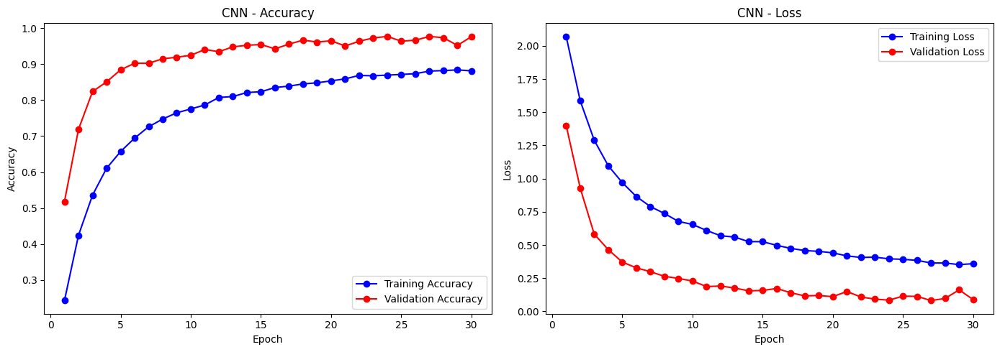

 Saved: /kaggle/working/CNN_training_plot.png
 Saved: /kaggle/working/CNN_training_history.xlsx


In [20]:
plot_and_save_history(history, model_name="CNN")

The simple CNN model shows strong performance on the State Farm Distracted Driver dataset. Training accuracy improves steadily over time, reaching about 88%, while validation accuracy rises quickly and levels off around 96–97%. Interestingly, validation accuracy stays higher than training, which suggests the model generalizes well—possibly due to dropout or data augmentation during training. The loss curves back this up, showing consistent improvement with no signs of overfitting. Overall, the model handles the task well and seems to capture the key patterns needed to differentiate between distracted driving behaviors.

## 🧠 CNN Model Architecture and Training Strategy

To classify distracted driver behaviors, we designed a lightweight yet effective **3-layer Convolutional Neural Network (CNN)**. The model balances simplicity and depth, enabling fast training while capturing meaningful visual patterns.

---

### 📐 Model Architecture

| Layer          | Filters | Kernel | Padding | Activation | Description                                    |
|----------------|---------|--------|---------|------------|------------------------------------------------|
| Conv2D         | 32      | 3x3    | Same    | ReLU       | Captures basic edges, colors, and textures     |
| MaxPooling2D   | -       | 2x2    | -       | -          | Reduces spatial size, prevents overfitting     |
| Conv2D         | 64      | 3x3    | Same    | ReLU       | Learns mid-level patterns like hands or faces  |
| MaxPooling2D   | -       | 2x2    | -       | -          | Downsamples further                            |
| Conv2D         | 128     | 3x3    | Same    | ReLU       | Learns fine-grained cues (e.g., phones, cups)  |
| MaxPooling2D   | -       | 2x2    | -       | -          | Final spatial reduction                        |
| Flatten        | -       | -      | -       | -          | Converts 3D to 1D feature vector                |
| Dense + Dropout| 128     | -      | -       | ReLU       | Fully connected layer with 50% dropout         |
| Output Layer   | 10      | -      | -       | Softmax    | Predicts one of 10 behavior classes            |

---

### Regularization and Optimization

To combat overfitting and maximize generalization — especially given the **imbalanced and nuanced nature of the State Farm dataset** — we use the following strategies:

#### **Dropout (0.5)**
- Randomly disables 50% of neurons during training
- Prevents the network from relying too heavily on any one feature
- Essential for preventing memorization of specific driver postures

#### **Early Stopping**
- Stops training if the validation loss doesn’t improve for 5 consecutive epochs
- Saves the best model based on validation performance
- Prevents overfitting and wasted training time

#### **Learning Rate Scheduler**
- `ReduceLROnPlateau`: cuts learning rate by half if validation loss plateaus
- Helps the model fine-tune during later epochs by making smaller weight updates
- Critical for converging on **subtle inter-class differences** (e.g., left vs. right texting)

---

### Why This Matters for Our Dataset

The **State Farm Distracted Driver Detection dataset** presents several unique modeling challenges:
- Subtle differences between classes (e.g., 'texting right' vs. 'talking right')
- Limited training data for some classes
- Variations in lighting, hand position, and camera angle

Our CNN architecture, paired with regularization and adaptive learning, allows us to:
- Learn robust, generalizable features
- Avoid overfitting to dominant or repetitive class patterns
- Improve convergence and model confidence in edge cases

---


# ResNet50

For this section, we explore ResNet50, a deeper convolutional architecture that uses residual connections to preserve feature quality across layers. We start with a shallow approach by freezing the pretrained base, then fine-tune the full model. This strategy allows us to leverage robust ImageNet features while gradually adapting to the subtle visual cues in our driver behavior dataset, such as hand positioning and object interaction.

# Shallow Resnet

We introduce a shallow ResNet50 model using a pretrained ImageNet backbone to efficiently capture visual patterns relevant to driver behavior. By freezing the convolutional base initially, we train a lightweight classifier on top, then fine-tune the full model to adapt the learned features to our dataset. This two-step approach balances generalization and specialization, leveraging residual connections to retain useful information while refining task-specific details.

In [17]:
def build_shallow_resnet50(input_shape=(240, 240, 3), num_classes=10):
    base_model = ResNet50(weights='imagenet', include_top=False, input_tensor=Input(shape=input_shape))
    base_model.trainable = False  # Freeze for warmup

    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.5)(x)
    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=output)
    return model

# Initialize and compile frozen model
shallow_resnet50 = build_shallow_resnet50()
shallow_resnet50.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


# Warmup Training
history_warmup = shallow_resnet50.fit(
    train_generator,
    validation_data=val_generator,
    epochs=5,
    callbacks=[early_stop, lr_scheduler]
)

# Unfreeze ResNet50
shallow_resnet50.trainable = True

# Re-compile with lower learning rate for fine-tuning
shallow_resnet50.compile(
    optimizer=Adam(learning_rate=1e-5),  # smaller LR for fine-tuning
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Fine-tuning (preparation for full modeling in next code chunk)
history_finetune = shallow_resnet50.fit(
    train_generator,
    validation_data=val_generator,
    epochs=15,
    callbacks=[early_stop, lr_scheduler]
)

Epoch 1/5


I0000 00:00:1753626550.950687      96 service.cc:148] XLA service 0x7f83340048f0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1753626550.951771      96 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1753626552.475260      96 cuda_dnn.cc:529] Loaded cuDNN version 90300


  2/561 ━━━━━━━━━━━━━━━━━━━━ 31s 56ms/step - accuracy: 0.0625 - loss: 2.6032   

I0000 00:00:1753626556.689756      96 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


561/561 ━━━━━━━━━━━━━━━━━━━━ 424s 729ms/step - accuracy: 0.1096 - loss: 2.3672 - val_accuracy: 0.1770 - val_loss: 2.2870 - learning_rate: 1.0000e-04
Epoch 2/5
561/561 ━━━━━━━━━━━━━━━━━━━━ 266s 473ms/step - accuracy: 0.1177 - loss: 2.2949 - val_accuracy: 0.1312 - val_loss: 2.2817 - learning_rate: 1.0000e-04
Epoch 3/5
561/561 ━━━━━━━━━━━━━━━━━━━━ 261s 465ms/step - accuracy: 0.1306 - loss: 2.2915 - val_accuracy: 0.1502 - val_loss: 2.2668 - learning_rate: 1.0000e-04
Epoch 4/5
561/561 ━━━━━━━━━━━━━━━━━━━━ 260s 463ms/step - accuracy: 0.1323 - loss: 2.2838 - val_accuracy: 0.1504 - val_loss: 2.2588 - learning_rate: 1.0000e-04
Epoch 5/5
561/561 ━━━━━━━━━━━━━━━━━━━━ 257s 459ms/step - accuracy: 0.1490 - loss: 2.2750 - val_accuracy: 0.2212 - val_loss: 2.2407 - learning_rate: 1.0000e-04
Epoch 1/15
561/561 ━━━━━━━━━━━━━━━━━━━━ 278s 473ms/step - accuracy: 0.1623 - loss: 2.2662 - val_accuracy: 0.2031 - val_loss: 2.2402 - learning_rate: 1.0000e-05
Epoch 2/15
561/561 ━━━━━━━━━━━━━━━━━━━━ 256s 455ms/step

In [18]:
shallow_resnet50 = build_shallow_resnet50()

shallow_resnet50.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Train full, fine-tuned model
history_shallow = shallow_resnet50.fit(
    train_generator,
    epochs=30,
    validation_data=val_generator,
    callbacks=[early_stop, lr_scheduler]
)

Epoch 1/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 294s 501ms/step - accuracy: 0.1065 - loss: 2.3741 - val_accuracy: 0.1357 - val_loss: 2.2871 - learning_rate: 1.0000e-04
Epoch 2/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 272s 485ms/step - accuracy: 0.1199 - loss: 2.2937 - val_accuracy: 0.1109 - val_loss: 2.2793 - learning_rate: 1.0000e-04
Epoch 3/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 272s 484ms/step - accuracy: 0.1262 - loss: 2.2893 - val_accuracy: 0.1259 - val_loss: 2.2717 - learning_rate: 1.0000e-04
Epoch 4/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step - accuracy: 0.1404 - loss: 2.2808

KeyboardInterrupt: 

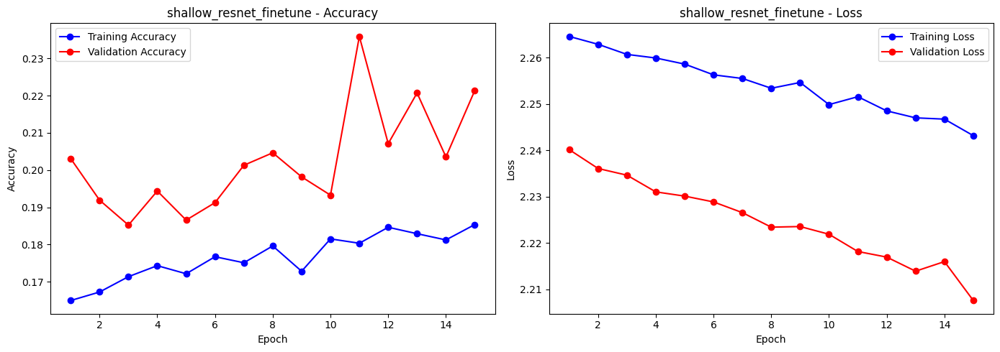

 Saved: /kaggle/working/shallow_resnet_finetune_training_plot.png
 Saved: /kaggle/working/shallow_resnet_finetune_training_history.xlsx


In [22]:
plot_and_save_history(history_finetune, model_name="shallow_resnet_finetune")

After training the shallow ResNet50—where the pretrained base was initially frozen and later fine-tuned—validation accuracy plateaued at around 23%, prompting us to pause and reassess. We then transitioned to a deeper ResNet approach with all layers trainable from the start. This allows the model to fully adapt both low- and high-level features to the dataset, with the goal of capturing more nuanced patterns in driver behavior. By training end-to-end, we aim to improve generalization and push performance beyond the limits of the shallow model.

# Deep Resnet

In [23]:
def build_deep_resnet50(input_shape=(240, 240, 3), num_classes=10):
    base_model = ResNet50(weights='imagenet', include_top=False, input_tensor=Input(shape=input_shape))
    base_model.trainable = True  # Unfreeze all layers

    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(512, activation='relu')(x)
    x = Dropout(0.5)(x)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.3)(x)
    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=output)
    return model


deep_resnet50 = build_deep_resnet50()


deep_resnet50.compile(
    optimizer=Adam(learning_rate=1e-5),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


history_deep_resnet = deep_resnet50.fit(
    train_generator,
    validation_data=val_generator,
    epochs=30,
    callbacks=[early_stop, lr_scheduler]
)


deep_resnet50.summary()


Epoch 1/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 401s 584ms/step - accuracy: 0.1809 - loss: 2.2852 - val_accuracy: 0.1198 - val_loss: 2.4665 - learning_rate: 1.0000e-05
Epoch 2/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 302s 538ms/step - accuracy: 0.7695 - loss: 0.7977 - val_accuracy: 0.9536 - val_loss: 0.1700 - learning_rate: 1.0000e-05
Epoch 3/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 285s 508ms/step - accuracy: 0.9365 - loss: 0.2354 - val_accuracy: 0.9826 - val_loss: 0.0638 - learning_rate: 1.0000e-05
Epoch 4/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 266s 474ms/step - accuracy: 0.9673 - loss: 0.1270 - val_accuracy: 0.9873 - val_loss: 0.0465 - learning_rate: 1.0000e-05
Epoch 5/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 272s 485ms/step - accuracy: 0.9810 - loss: 0.0753 - val_accuracy: 0.9893 - val_loss: 0.0324 - learning_rate: 1.0000e-05
Epoch 6/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 270s 482ms/step - accuracy: 0.9866 - loss: 0.0503 - val_accuracy: 0.9837 - val_loss: 0.0525 - learning_rate: 1.0000e-05
Epoch 7/30
561/561 ━━━━━━━━━━━━━━━━━━━━ 

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 240, 240,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 246, 246,  │          0 │ input_layer_4[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 120, 120,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 120, 120,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 120, 120,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 122, 122,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 60, 60,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 60, 60,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 60, 60,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 60, 60,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 60, 60,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 60, 60,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 60, 60,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 60, 60,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 60, 60,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 60, 60,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 60, 60,    │      1,024 │ conv2_block1_3_c

 Total params: 74,205,856 (283.07 MB)

 Trainable params: 24,717,578 (94.29 MB)

 Non-trainable params: 53,120 (207.50 KB)

 Optimizer params: 49,435,158 (188.58 MB)

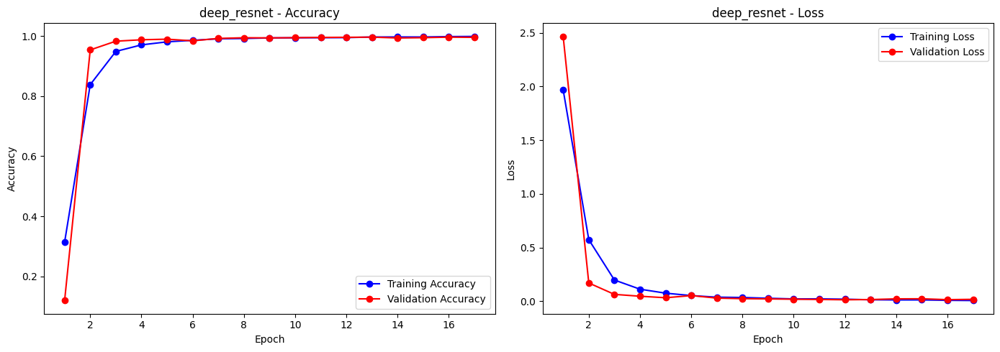

 Saved: /kaggle/working/deep_resnet_training_plot.png
 Saved: /kaggle/working/deep_resnet_training_history.xlsx


In [24]:
plot_and_save_history(history_deep_resnet, model_name="deep_resnet")

# Conclusion


Our custom CNN performed surprisingly well, reaching around 97% validation accuracy with stable loss and no signs of overfitting. In contrast, the shallow ResNet50—using a frozen base with later fine-tuning—struggled, topping out at just 23% accuracy. Once we moved to a deeper ResNet50 and trained the entire model end-to-end, performance improved significantly. The model quickly surpassed the shallow version and achieved over 99% training accuracy and about 99.5% on validation, showing strong generalization and a good fit for the task

If we were to continue this project, the next steps would be:

Try smaller models like MobileNet or EfficientNet for faster inference and potential edge deployment.

Explore ensemble methods or test-time augmentation to further push accuracy.

Evaluate the model’s robustness under different conditions—like blurry images or varied lighting—to better simulate real-world driving environments.